In [ ]:
from google.colab import drive
drive.mount("./drive")

Mounted at ./drive


In [ ]:
import cv2 
import numpy as np
import pandas as pd

def avg_circles(circles, b):
    avg_x=0
    avg_y=0
    avg_r=0
    for i in range(b):
        #optional - average for multiple circles (can happen when a gauge is at a slight angle)
        avg_x = avg_x + circles[0][i][0]
        avg_y = avg_y + circles[0][i][1]
        avg_r = avg_r + circles[0][i][2]
    avg_x = int(avg_x/(b))
    avg_y = int(avg_y/(b))
    avg_r = int(avg_r/(b))
    return avg_x, avg_y, avg_r

def dist_2_pts(x1, y1, x2, y2):
    #print np.sqrt((x2-x1)^2+(y2-y1)^2)
    return np.sqrt((x2 - x1)**2 + (y2 - y1)**2)

def region_of_interest(img, vertices):
    mask= np.zeros_like(img)
    match_mask_color= 255
    cv2.fillPoly(mask, vertices, match_mask_color)
    masked_image= cv2.bitwise_and(img, mask)
    return masked_image



In [ ]:
file_path = "/content/drive/MyDrive/gauge_classification/chiller_gauge.jpeg"
img = cv2.imread(file_path)

In [ ]:
# replicated image
output= img.copy()
output1= img.copy()
output2= img.copy()
output3= img.copy()
output4= img.copy()
output5= img.copy()
output6= img.copy()

# turn BGR to GRAY 
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

width, height = gray.shape[:2]
circle_img= cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT,1, 20, np.array([]), 100, 50, int(height*0.35), int(height*0.50))
a, b, c = circle_img.shape
circle_img


array([[[1018.5, 1039.5,  808.1],
        [1045.5, 1090.5,  771.8],
        [1024.5, 1080.5,  791.2],
        ...,
        [ 621.5, 1102.5,  841. ],
        [ 622.5, 1081.5,  766.2],
        [ 620.5, 1010.5,  755.2]]], dtype=float32)

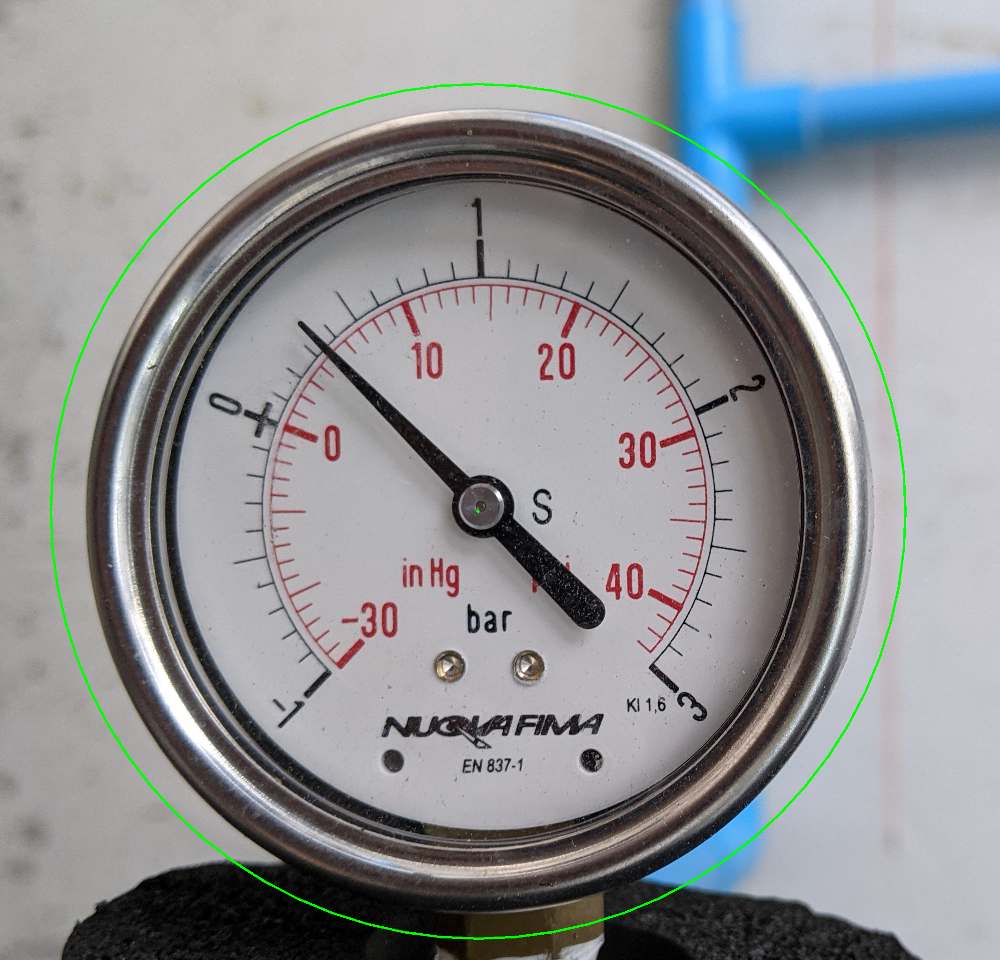

In [ ]:
x,y,r = avg_circles(circle_img, b)
cv2.circle(output3, (x,y), r, (0,255,0), 3)
cv2.circle(output3, (x,y), 2, (0,255,0), 3)
cv2_imshow(output3)

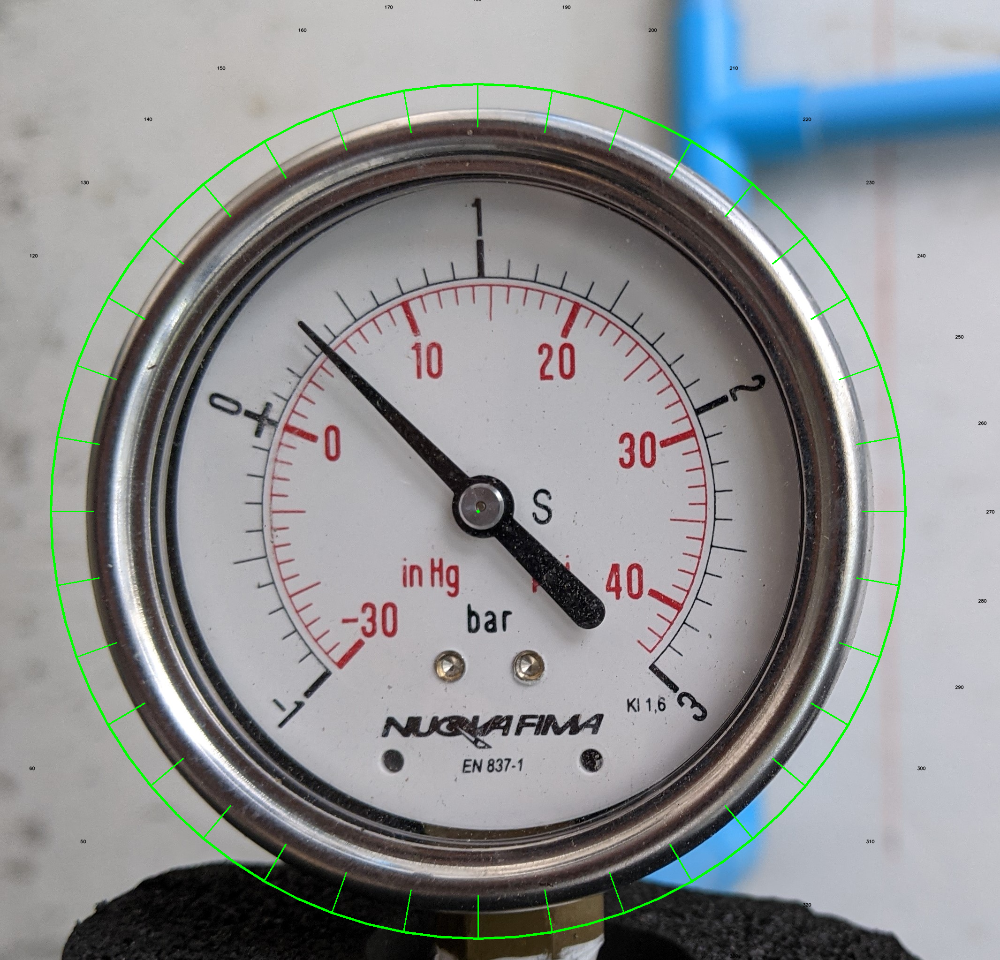

In [ ]:
# Draw scale of degree on image
separation= 10 #in degrees
interval = int(360/separation)
p1 = np.zeros((interval,2))  #set empty arrays
p2 = np.zeros((interval,2))
p_text = np.zeros((interval,2))    

for i in range(0,interval):
    for j in range(0,2):
        if (j%2==0):
            p1[i][j] = x + 0.9 * r * np.cos(separation * i * np.pi / 180) #point for lines
        else:
            p1[i][j] = y + 0.9 * r * np.sin(separation * i * np.pi / 180)

text_offset_x = 10
text_offset_y = 5

for i in range(0, interval):
    for j in range(0, 2):
        if (j % 2 == 0):
            p2[i][j] = x + r * np.cos(separation * i * np.pi / 180)
            p_text[i][j] = x - text_offset_x + 1.2 * r * np.cos((separation) * (i+9) * np.pi / 180) #point for text labels, i+9 rotates the labels by 90 degrees
        else:
            p2[i][j] = y + r * np.sin(separation * i * np.pi/ 180)
            p_text[i][j] = y + text_offset_y + 1.2* r * np.sin((separation) * (i+9) * np.pi / 180)  # point for text labels, i+9 rotates the labels by 90 degrees

#add the lines and labels to the image
for i in range(0,interval):
    cv2.line(output3, (int(p1[i][0]), int(p1[i][1])), (int(p2[i][0]), int(p2[i][1])),(0, 255, 0), 2)
    cv2.putText(output3, '%s' %(int(i*separation)), (int(p_text[i][0]), int(p_text[i][1])), cv2.FONT_HERSHEY_SIMPLEX, 0.3,(0,0,0),1,cv2.LINE_AA)

cv2_imshow(output3)


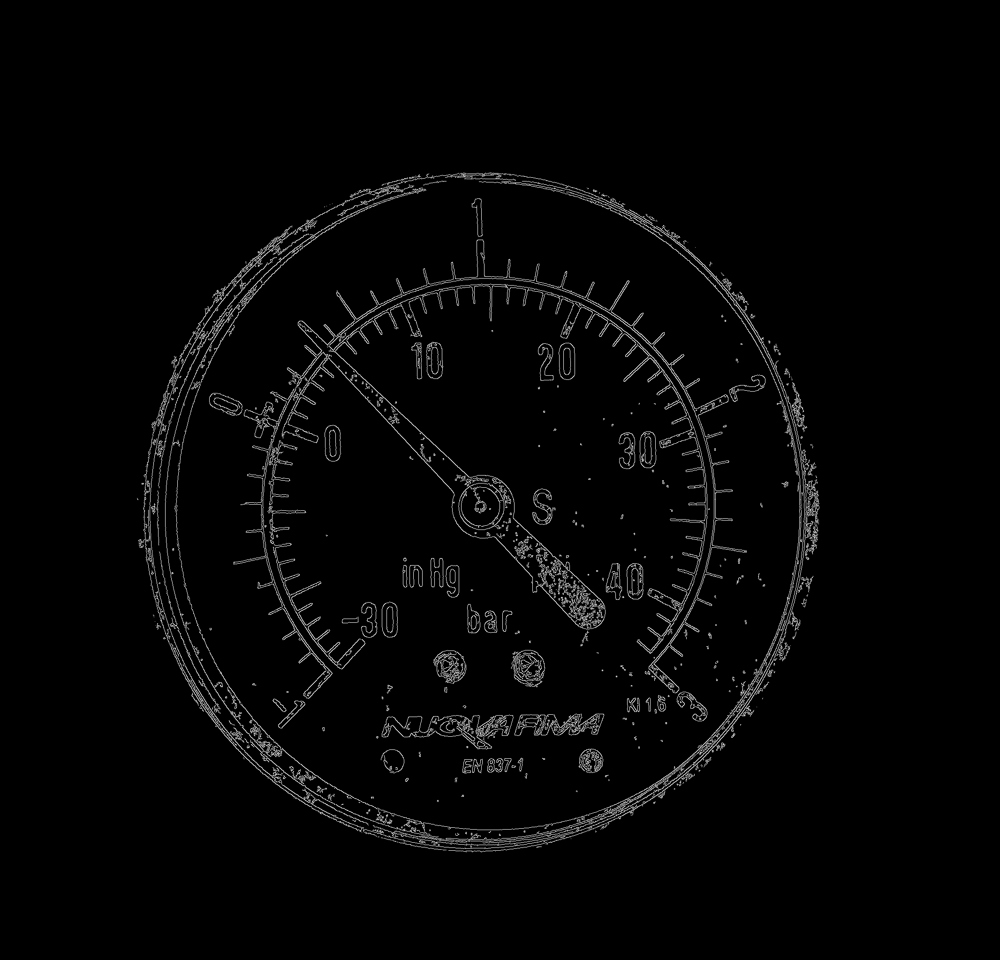

In [ ]:
# Edge detection
separation= 10 #in degrees
interval = int(360/separation)
p3 = np.zeros((interval,2))  #set empty arrays
p4 = np.zeros((interval,2))


for i in range(0,interval):
    for j in range(0,2):
        if (j%2==0):
            p3[i][j] = x + 0.8 * r * np.cos(separation * i * np.pi / 180) #point for lines
        else:
            p3[i][j] = y + 0.8 * r * np.sin(separation * i * np.pi / 180)


canny= cv2.Canny(gray, 200, 20)
region_of_interest_vertices= p3
cropped_image= region_of_interest(canny, np.array([region_of_interest_vertices], np.int32))

cv2_imshow(cropped_image)

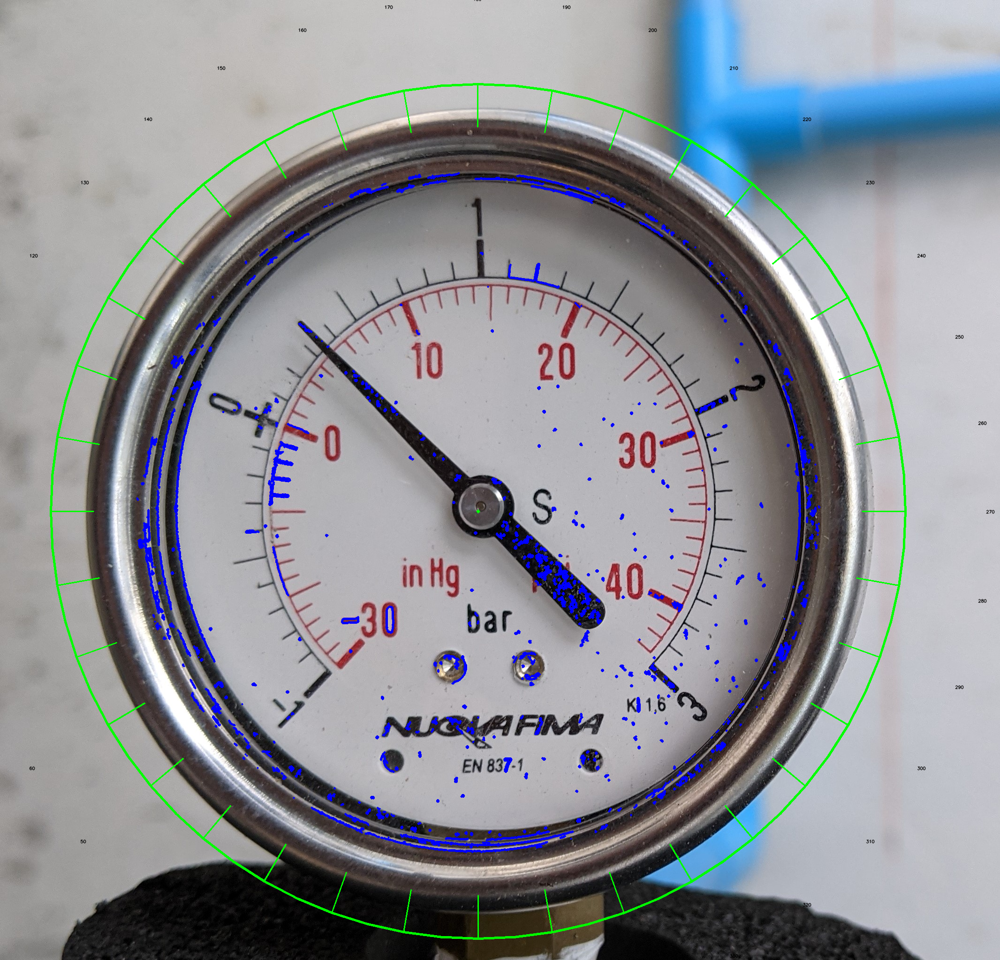

In [ ]:
contours, heirarchy= cv2.findContours(cropped_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
int_cnt= []
for cnt in contours:
    area = cv2.contourArea(cnt)
    if area<15:
        cv2.drawContours(output3, cnt, -1, (255,0,0), 3)
        int_cnt.append(cnt) 

cv2_imshow(output3)

In [ ]:
# Estimate Angle min and max
frth_quad_index=[]
thrd_quad_index=[]
reference_zero_angle= 35
reference_end_angle= 330
min_angle=90
max_angle=270

for i in range(len(int_cnt)):
    a= int_cnt[i]
    a= a.reshape(len(a),2)
    a= pd.DataFrame(a)        
    x1= a.iloc[:,0].mean()
    y1= a.iloc[:,1].mean()
    
    xlen= x1-x
    ylen= y-y1

    #Taking arc-tan of ylen/xlen to find the angle
    #res= np.arctan(np.divide(float(ylen), float(xlen)))
    #res= np.rad2deg(res)
    if xlen<0 and ylen<0:
        res= np.arctan(np.divide(float(abs(ylen)), float(abs(xlen))))
        res= np.rad2deg(res)
        final_start_angle= 90-res
        #print(i , final_angle)
        frth_quad_index.append(i)
        if final_start_angle> reference_zero_angle:
            if final_start_angle<min_angle:
                min_angle= final_start_angle
        
    elif xlen>0 and ylen<0:
        res= np.arctan(np.divide(float(abs(ylen)), float(abs(xlen))))
        res= np.rad2deg(res)
        final_end_angle= 270+res
        thrd_quad_index.append(i)
        #print(i , res)
        if final_end_angle<reference_end_angle:
            if final_end_angle>max_angle:
                max_angle= final_end_angle

print(f'Zero reading corresponds to {min_angle}')
print(f'End reading corresponds to {max_angle}')

Zero reading corresponds to 35.784200098951196
End reading corresponds to 328.8185799159612


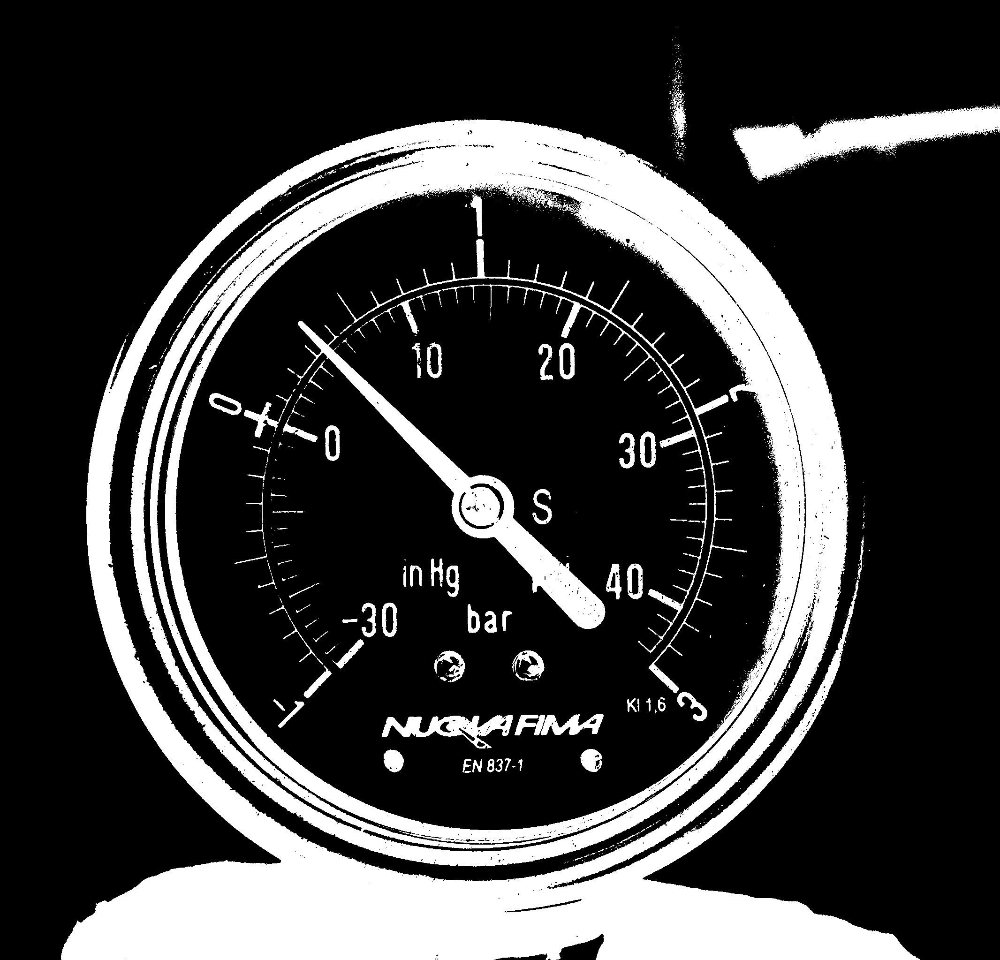

In [ ]:
#Trial and error to see which threshold function performs best 
thresh= 100
maxValue= 255

th, dst2 = cv2.threshold(gray, thresh, maxValue, cv2.THRESH_BINARY_INV)

cv2_imshow(dst2)

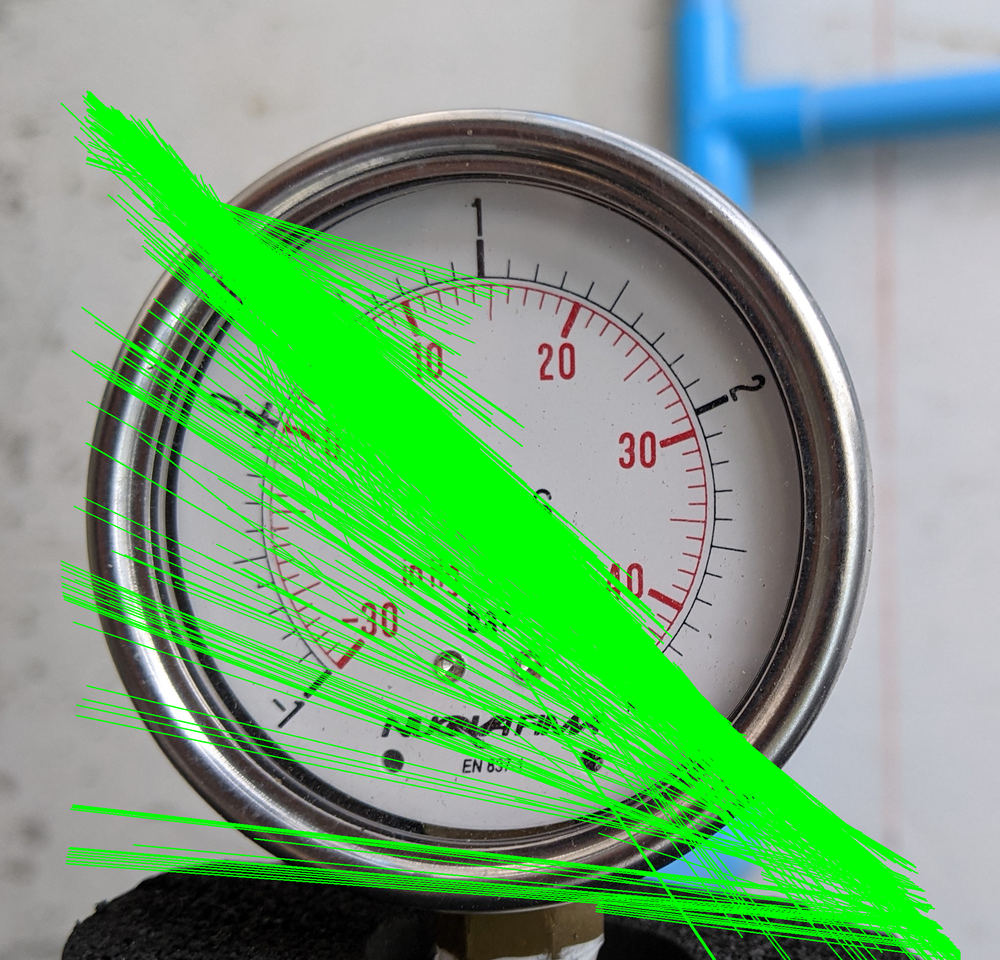

In [ ]:
minLineLength = 10
maxlineGap   = 0

lines = cv2.HoughLinesP(image=dst2, rho=3, theta=np.pi / 180, threshold=100,minLineLength=minLineLength, maxLineGap=0) 
for line in lines:
    x1, x2, y1, y2= line[0]
    cv2.line(output1, (x1, y1), (x2, y2), (0,255,0), 2)

cv2_imshow(output1)

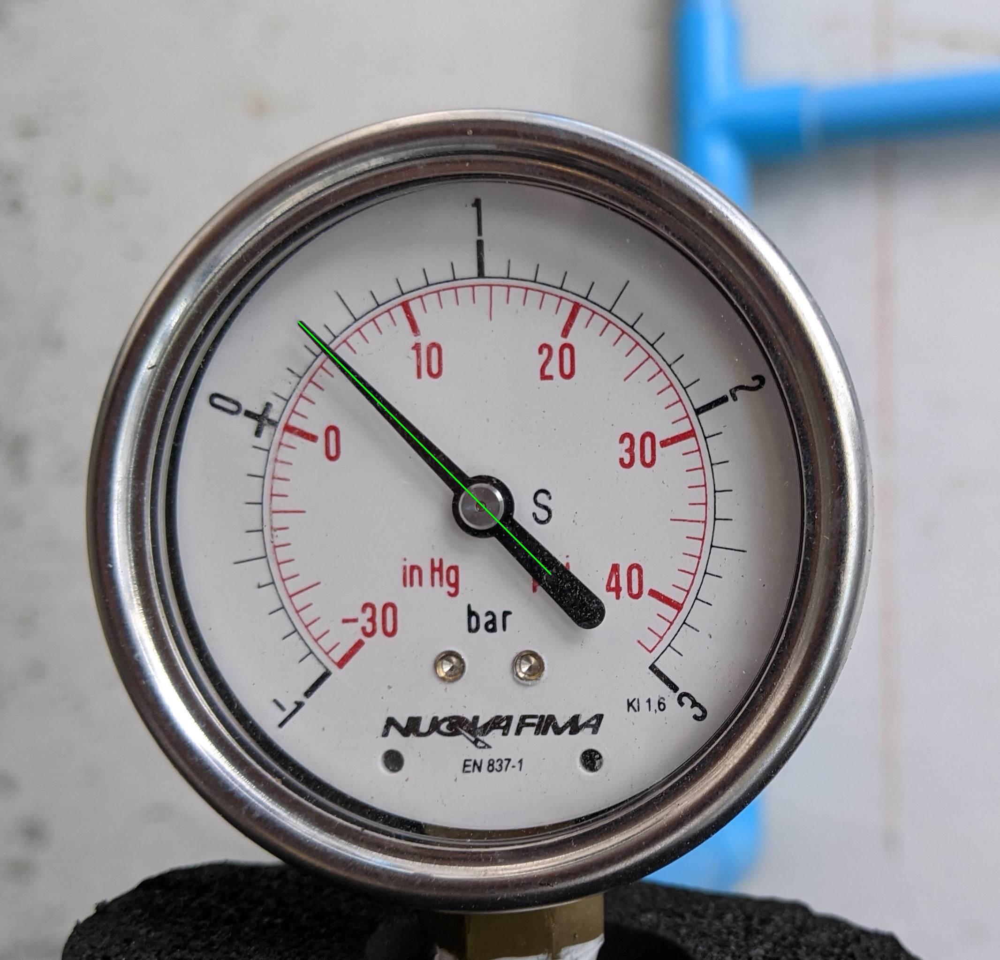

In [ ]:
final_line_list = []
diff1LowerBound = 0.15 #diff1LowerBound and diff1UpperBound determine how close the line should be from the center
diff1UpperBound = 0.35
diff2LowerBound = 0.5 #diff2LowerBound and diff2UpperBound determine how close the other point of the line should be to the outside of the gauge
diff2UpperBound = 1.0
for i in range(0, len(lines)):
    for x1, y1, x2, y2 in lines[i]:
        diff1 = dist_2_pts(x, y, x1, y1)  # x, y is center of circle
        diff2 = dist_2_pts(x, y, x2, y2)  # x, y is center of circle
        #set diff1 to be the smaller (closest to the center) of the two), makes the math easier
        if (diff1 > diff2):
            temp = diff1
            diff1 = diff2
            diff2 = temp
        # check if line is within an acceptable range
        if (((diff1<diff1UpperBound*r) and (diff1>diff1LowerBound*r) and (diff2<diff2UpperBound*r)) and (diff2>diff2LowerBound*r)):
            line_length = dist_2_pts(x1, y1, x2, y2)
            # add to final list
            final_line_list.append([x1, y1, x2, y2])
            
x1 = final_line_list[0][0]
y1 = final_line_list[0][1]
x2 = final_line_list[0][2]
y2 = final_line_list[0][3]
cv2.line(output6, (x1, y1), (x2, y2), (0, 255, 0), 2)

cv2_imshow(output6)


In [ ]:
min_value = -1
max_value = 3

In [ ]:
# Determine final angle
dist_pt0 = dist_2_pts(x,y,x1,y1)
dist_pt1 = dist_2_pts(x,y,x2,y2)

if (dist_pt0 > dist_pt1):
    xlen= x1-x
    ylen= y-y1
else:
    xlen= x2-x
    ylen= y-y2
    
#Taking arc-tan of ylen/xlen to find the angle
res= np.arctan(np.divide(float(abs(ylen)), float(abs(xlen))))
res= np.rad2deg(res)

if xlen<0 and ylen>0:                 #Quadrant 1
    final_angle= res+90
if xlen>0 and ylen>0:                 #Quadrant 2
    final_angle= 270-res
if xlen>0 and ylen<0:                 #Quadrant 3
    final_angle= 270+res
if xlen<0 and ylen<0:                 #Quadrant 4
    final_angle= 90-res


print(final_angle)

136.52849545557922


In [ ]:
# Read current value
old_min = float(min_angle)
old_max = float(max_angle)

new_min = float(min_value)
new_max = float(max_value)

old_value = final_angle

old_range = (old_max - old_min)
new_range = (new_max - new_min)
new_value = (((old_value - old_min) * new_range) / old_range) + new_min
print(new_value)

0.37518738135149055


In [ ]:
print(f"{new_value:.2f}")

0.38


In [ ]:
import math

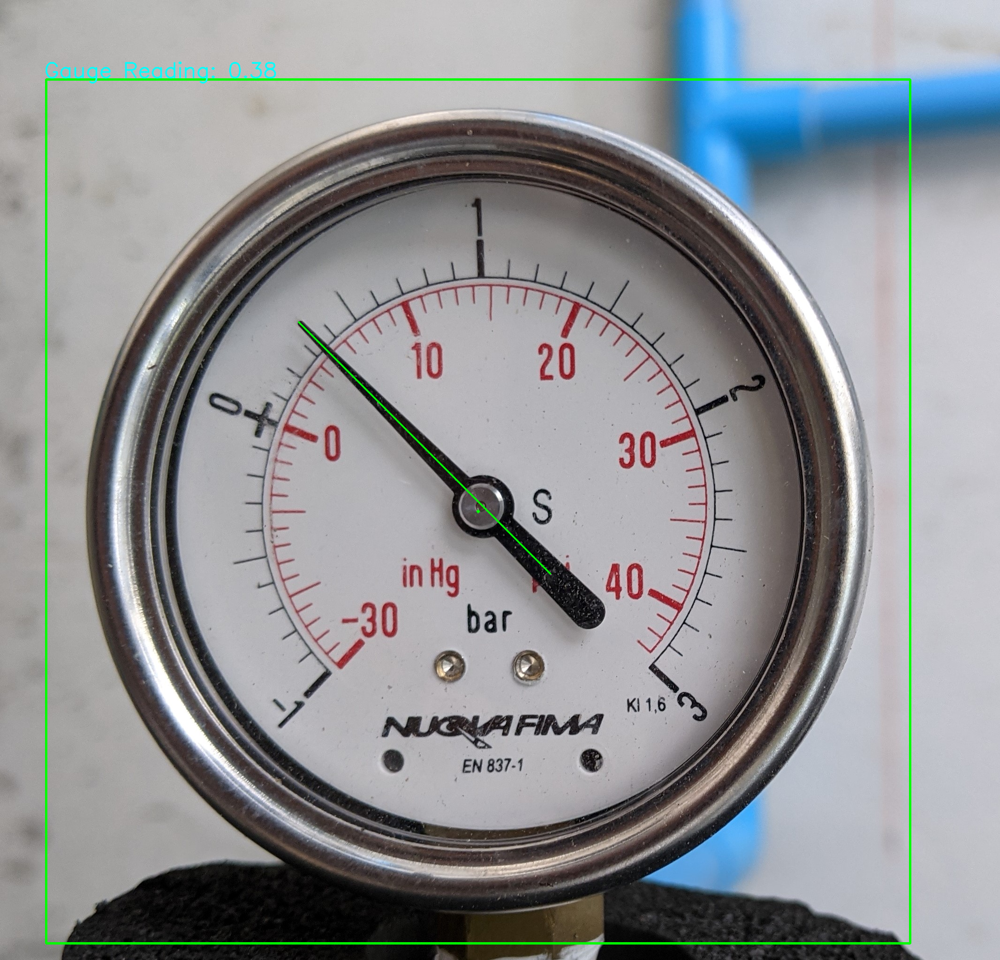

In [ ]:
cv2.rectangle(output6, (x-(r+10), y-(r+10)), (x+(r+10),y+(r+10)), (0,255,0), 3)
cv2.putText(output6, 'Gauge Reading: {:.2f}'.format(new_value), (int(x-(r+14)),int(y-(r+14))), 
                cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,0), 2, cv2.LINE_AA) 
cv2.circle(output6, (x,y), 2, (0,255,0), 3)

cv2_imshow(output6)

### Test hough line detection

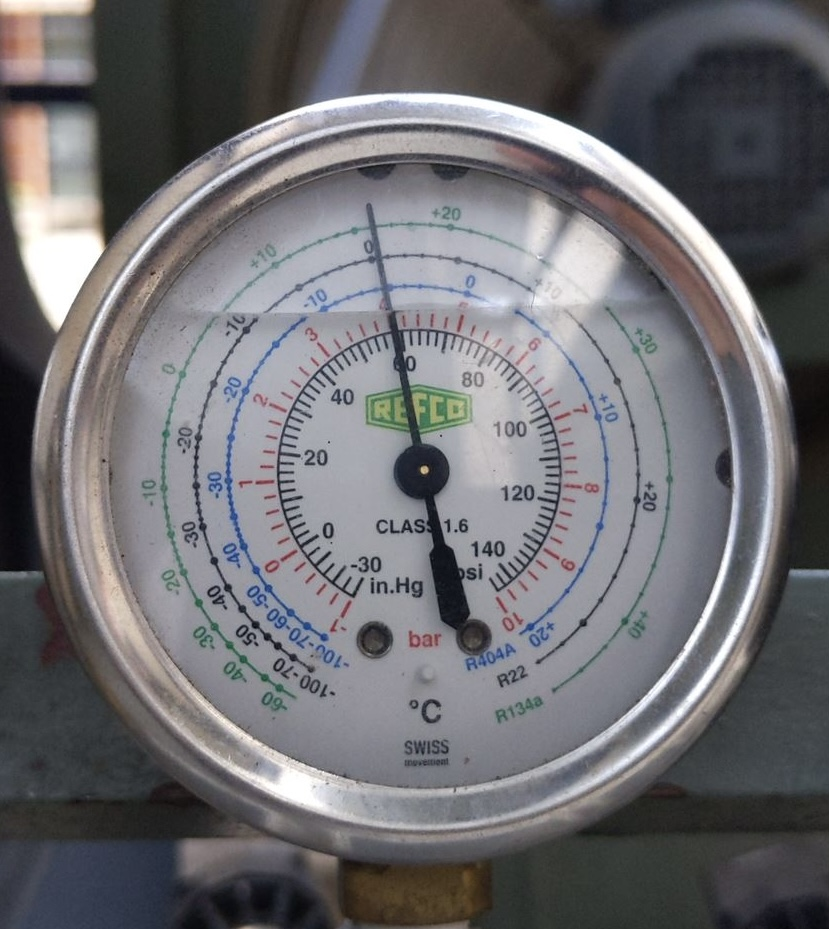

In [ ]:
gauge_1 = cv2.imread("/content/drive/MyDrive/gauge_classification/31296ec7-4067-4de3-9a0c-cf4fe8a814ae.jpg")
cv2_imshow(gauge_1)

In [ ]:
gauge_2 = gauge_1.copy()
gauge_3 = gauge_1.copy()
gauge_4 = gauge_1.copy()
gauge_5 = gauge_1.copy()
gauge_6 = gauge_1.copy()

In [ ]:
gray = cv2.cvtColor(gauge_4, cv2.COLOR_BGR2GRAY)

width, height = gray.shape[:2]
circle_img= cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT,1, 20, np.array([]), 100, 50, int(height*0.35), int(height*0.50))
a, b, c = circle_img.shape
x,y,r = avg_circles(circle_img, b)
x, y, r

(421, 474, 319)

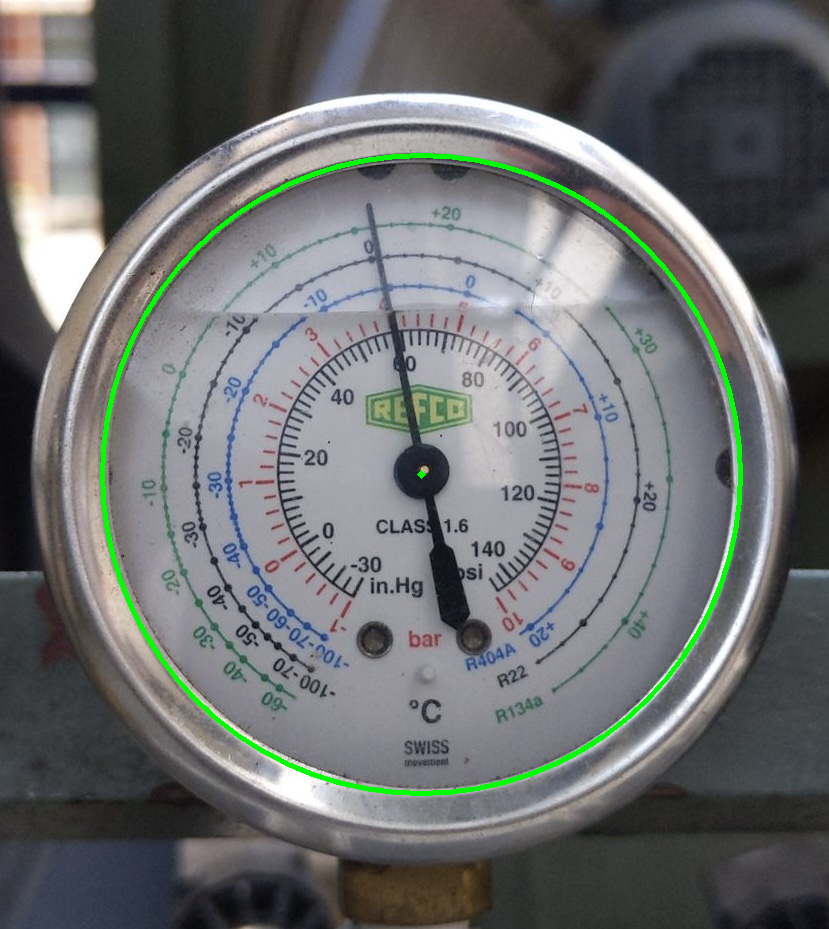

In [ ]:
x,y,r = avg_circles(circle_img, b)
cv2.circle(gauge_4, (x,y), r, (0,255,0), 3)
cv2.circle(gauge_4, (x,y), 2, (0,255,0), 3)
cv2_imshow(gauge_4)

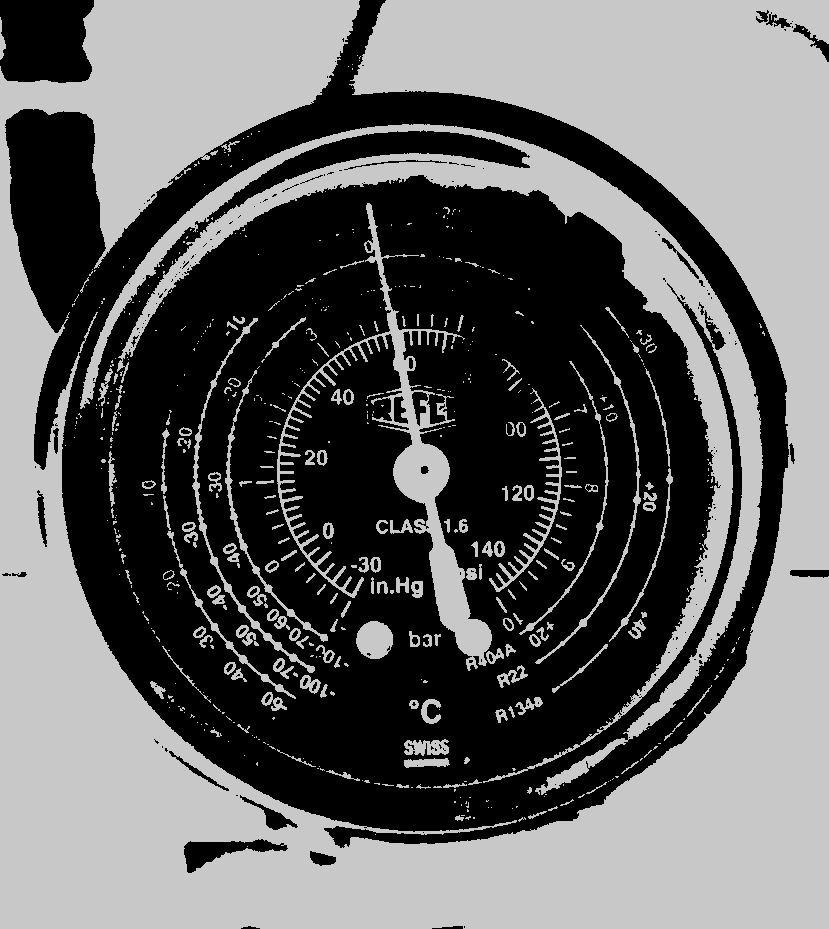

In [ ]:
thresh= 110
maxValue= 200

gray2 = cv2.cvtColor(gauge_1, cv2.COLOR_BGR2GRAY)

th, dst_1 = cv2.threshold(gray2, thresh, maxValue, cv2.THRESH_BINARY_INV)

cv2_imshow(dst_1)

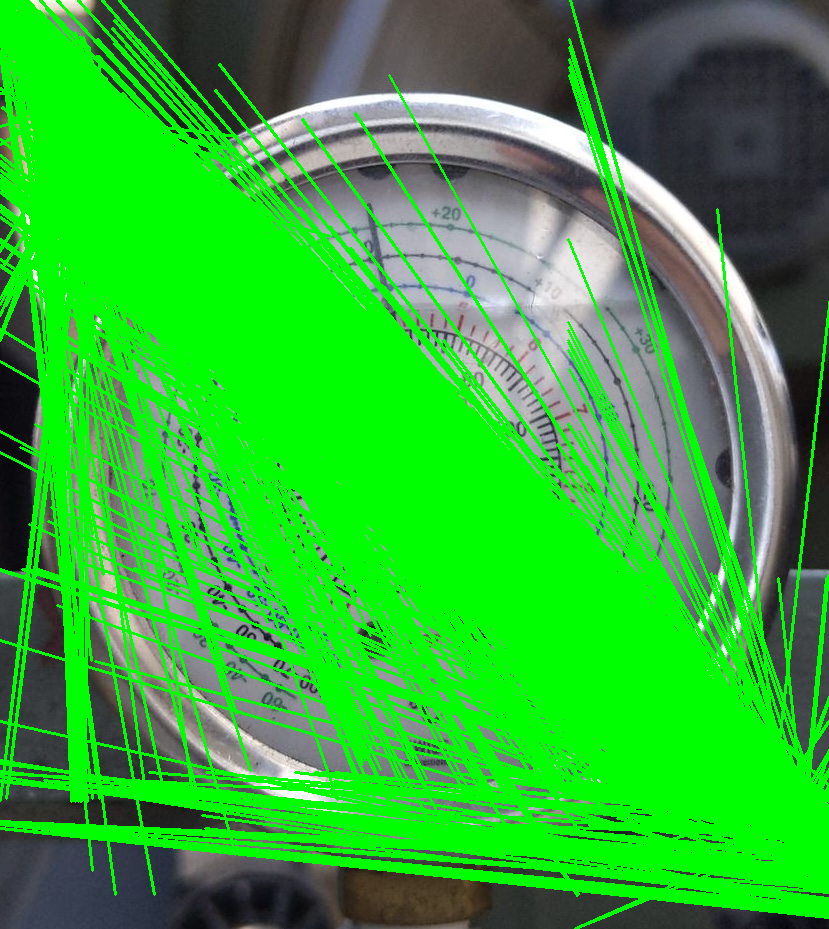

In [ ]:
minLineLength = 10
maxlineGap   = 0

lines = cv2.HoughLinesP(image=dst_1, rho=3, theta=np.pi / 180, threshold=100,minLineLength=minLineLength, maxLineGap=0) 
for line in lines:
    x1, x2, y1, y2= line[0]
    cv2.line(gauge_2, (x1, y1), (x2, y2), (0,255,0), 2)

cv2_imshow(gauge_2)

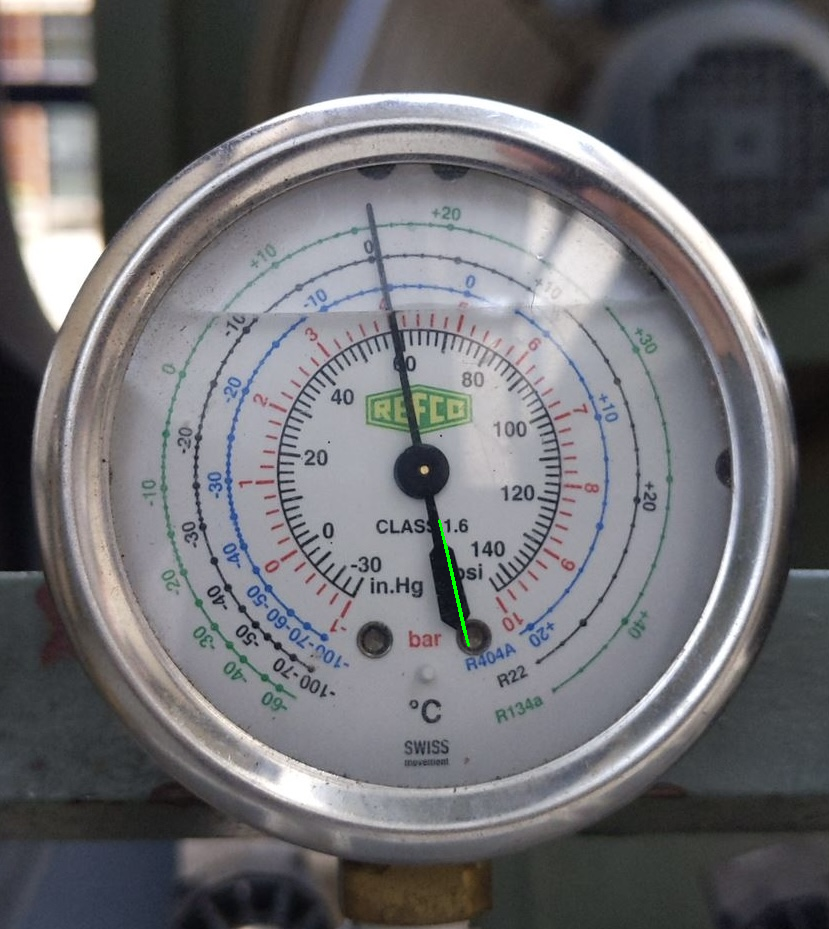

In [ ]:
final_line_list = []
diff1LowerBound = 0.15 #diff1LowerBound and diff1UpperBound determine how close the line should be from the center
diff1UpperBound = 0.35
diff2LowerBound = 0.5 #diff2LowerBound and diff2UpperBound determine how close the other point of the line should be to the outside of the gauge
diff2UpperBound = 1.0
for i in range(0, len(lines)):
    for x1, y1, x2, y2 in lines[i]:
        diff1 = dist_2_pts(x, y, x1, y1)  # x, y is center of circle
        diff2 = dist_2_pts(x, y, x2, y2)  # x, y is center of circle
        #set diff1 to be the smaller (closest to the center) of the two), makes the math easier
        if (diff1 > diff2):
            temp = diff1
            diff1 = diff2
            diff2 = temp
        # check if line is within an acceptable range
        if (((diff1<diff1UpperBound*r) and (diff1>diff1LowerBound*r) and (diff2<diff2UpperBound*r)) and (diff2>diff2LowerBound*r)):
            line_length = dist_2_pts(x1, y1, x2, y2)
            # add to final list
            final_line_list.append([x1, y1, x2, y2])
            
x1 = final_line_list[0][0]
y1 = final_line_list[0][1]
x2 = final_line_list[0][2]
y2 = final_line_list[0][3]
cv2.line(gauge_3, (x1, y1), (x2, y2), (0, 255, 0), 2)

cv2_imshow(gauge_3)

In [ ]:
final_line_list

[[439, 520, 467, 642]]